<a href="https://colab.research.google.com/github/krishnaagarwal1feb/Coursera-aml-Competitive-data-science/blob/master/future_sales.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### Data **Preprocessing**


In [ ]:
!unzip '/content/drive/My Drive/competitive-data-science-predict-future-sales.zip'

Archive:  /content/drive/My Drive/competitive-data-science-predict-future-sales.zip
  inflating: item_categories.csv     
  inflating: items.csv               
  inflating: sales_train.csv         
  inflating: sample_submission.csv   
  inflating: shops.csv               
  inflating: test.csv                


In [ ]:
!pip install googletrans
def trans(s):
  from googletrans import Translator
  translator = Translator()
  return (translator.translate(s).text)

  Created wheel for googletrans: filename=googletrans-2.4.0-cp36-none-any.whl size=15777 sha256=0f196504724bd4ad174b4415357a785d4c6e0a08b5d91dc50261e6770d777eb5
  Stored in directory: /root/.cache/pip/wheels/50/d6/e7/a8efd5f2427d5eb258070048718fa56ee5ac57fd6f53505f95
Successfully built googletrans


In [ ]:
import pandas as pd
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
shops = pd.read_csv('/content/shops.csv')
shops.columns
#shops.shop_name = shops.shop_name.apply(trans)

Index(['shop_name', 'shop_id'], dtype='object')

In [ ]:
shops.shape

(60, 2)

In [ ]:
item_cat = pd.read_csv('/content/item_categories.csv')
item_cat.columns
#item_cat.item_category_name = item_cat['item_category_name'].apply(trans)

Index(['item_category_name', 'item_category_id'], dtype='object')

In [ ]:
sales = pd.read_csv('/content/sales_train.csv')
sales.shape

(2935849, 6)

In [ ]:
items = pd.read_csv('/content/items.csv') #.drop(['item_name'],axis=1)
items.columns
#items.item_name = items.item_name.apply(trans)

Index(['item_name', 'item_id', 'item_category_id'], dtype='object')

In [ ]:
test = pd.read_csv('/content/test.csv')

In [ ]:
sub = pd.read_csv('/content/sample_submission.csv')

In [ ]:
data  = pd.merge(pd.merge(pd.merge(sales,items),shops),item_cat)
data.columns
data.shape

(2935849, 10)

In [ ]:
data.head()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_name,item_category_id,shop_name,item_category_name
0,02.01.2013,0,59,22154,999.0,1.0,ЯВЛЕНИЕ 2012 (BD),37,"Ярославль ТЦ ""Альтаир""",Кино - Blu-Ray
1,26.04.2013,3,59,944,150.0,1.0,2012 (BD),37,"Ярославль ТЦ ""Альтаир""",Кино - Blu-Ray
2,26.06.2013,5,59,944,199.5,1.0,2012 (BD),37,"Ярославль ТЦ ""Альтаир""",Кино - Blu-Ray
3,20.07.2013,6,59,944,199.5,1.0,2012 (BD),37,"Ярославль ТЦ ""Альтаир""",Кино - Blu-Ray
4,14.09.2013,8,59,944,299.0,2.0,2012 (BD),37,"Ярославль ТЦ ""Альтаир""",Кино - Blu-Ray


In [ ]:
#sns.pairplot(data)

In [ ]:
price = data.item_price
#sns.distplot(price,kde=False)
data[price > 900].shape


(775382, 10)

In [ ]:
print("dataset size ", data.shape)
print("data with item's price < 60k" , data[price < 60000].shape)

dataset size  (2935849, 10)
data with item's price < 60k (2935848, 10)


In [ ]:
price.max()

307980.0

In [ ]:
data[price  == price.max()]
#we are dropping this value

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_name,item_category_id,shop_name,item_category_name
2001605,13.12.2013,11,12,6066,307980.0,1.0,Radmin 3 - 522 лиц.,75,Интернет-магазин ЧС,Программы - Для дома и офиса


Text(0, 0.5, 'num of items with price =x')

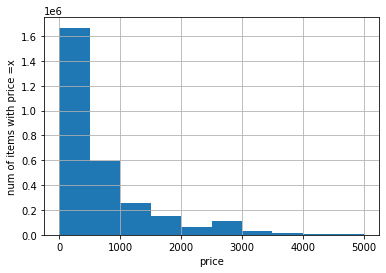

In [ ]:
data[price < 5000].item_price.hist()
plt.xlabel('price')
plt.ylabel('num of items with price =x')

In [ ]:
#plot category vs price 
#sns.scatterplot(data.shop_id,price,hue = (data.shop_id == 12))
#we observe here that shop_id = 12 : has in general high 

In [ ]:
data = data[data.item_price < 307980.0]
data.shape

(2935848, 10)

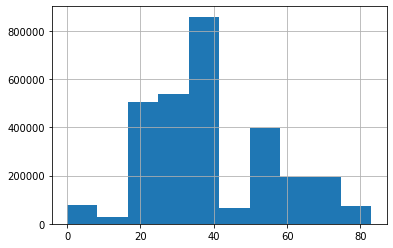

In [ ]:
data.item_category_id.hist()

1157.6274945330722


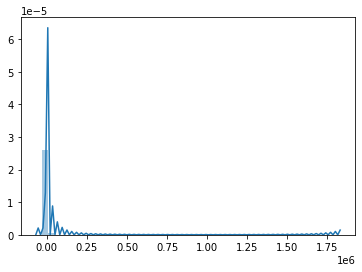

In [ ]:
bhatta = data['item_cnt_day']*data['item_price']
print(bhatta.mean())
sns.distplot(bhatta)


In [ ]:
bhatta.max(), bhatta.min()
#negative item cnt day represents return of item ?
bhatta.value_counts()
#so we see here some values near 300 rs has max profit because they can be daily needs
#so what is the shop id of these items ?


299.00      275443
149.00      213283
399.00      211631
199.00      176251
349.00       91918
             ...  
666.02           1
60858.00         1
6235.00          1
2529.19          1
996.02           1
Length: 24774, dtype: int64

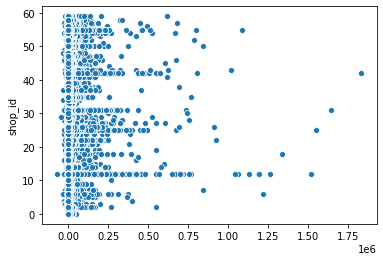

In [ ]:
#we can make a scatter plot of profit of every shop 
sns.scatterplot(bhatta,data.shop_id)

In [ ]:
data.columns
data[data.item_price<=0].item_price

872646   -1.0
Name: item_price, dtype: float64

In [ ]:
data = data[data.item_price > 0]

In [ ]:
item_cnt = data.item_cnt_day
print("item cnt per day min = {} \t max = {} \t mean = {}".format(item_cnt.min() , item_cnt.max() , item_cnt.mean()))

item cnt per day min = -22.0 	 max = 2169.0 	 mean = 1.2426410504362113


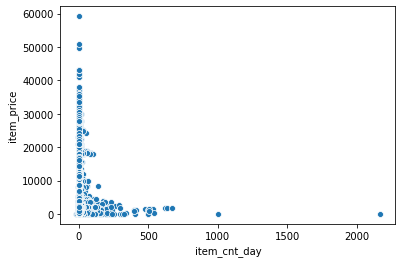

In [ ]:
sns.scatterplot(data.item_cnt_day , data.item_price)

In [ ]:
data[data.item_cnt_day >=  1000]
#so we see here is a shop which delivered emergency defence stuff and that made a huge quantity delivery in just one day 
#should we keep this feature ?
"""
The Russian military intervention in the Syrian Civil War began in September 2015,
 after an official request by the Syrian government for military aid against rebel groups. 
"""

'\nThe Russian military intervention in the Syrian Civil War began in September 2015,\n after an official request by the Syrian government for military aid against rebel groups. \n'

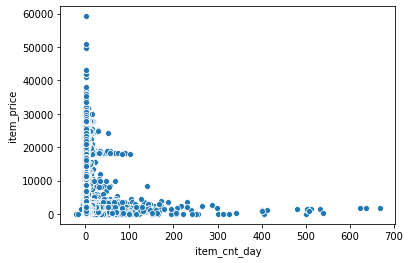

In [ ]:
data = data[data.item_cnt_day < 1000]
#sns.scatterplot(data.item_cnt_day , data.item_price)

In [ ]:
#sns.regplot(data.date_block_num, data.item_cnt_day)
#so we see in later months the item count of sales increase in a particular item being sold in high demand approximately in date_block=30 
#this feature i guess is not making much difference 

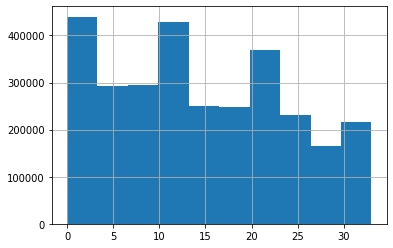

In [ ]:
#data.date_block_num.hist()

In [ ]:
data.shape

(2935849, 10)

In [ ]:
#sns.pairplot(data)
#after removing some outliers in itemcount and itemprice 

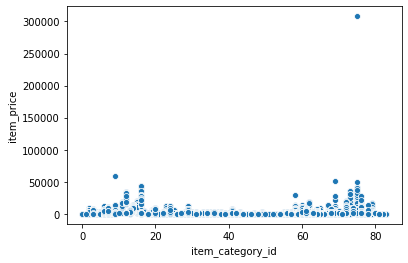

In [ ]:
x = data
sns.scatterplot(y = x.item_price , x = x.item_category_id)

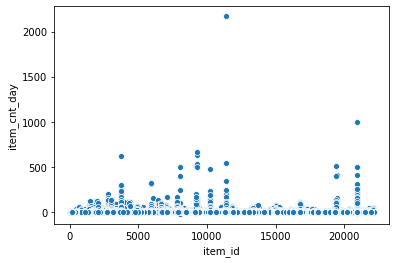

In [ ]:
sns.scatterplot(x.item_id, x.item_cnt_day)

date block starts with 0 and ends with 33


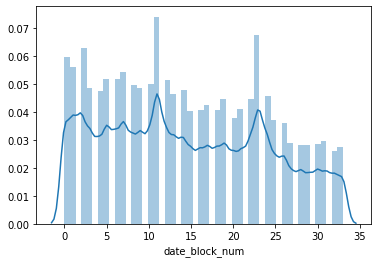

In [ ]:
sns.distplot(x.date_block_num)
#date block 11 and 23 has surge in number of items sold so we can observe what they sell and how much they sell
#we should check total sales as cnt*price for shops and plot a hist for that 
print("date block starts with {} and ends with {}".format(x.date_block_num.min(),x.date_block_num.max()))

11    143246
23    130786
2     121347
0     115690
1     108613
Name: date_block_num, dtype: int64

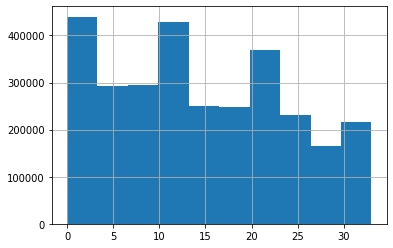

In [ ]:
x.date_block_num.hist()
x.date_block_num.value_counts().head()
# x.date_block_num.value_counts().mean() = 86348

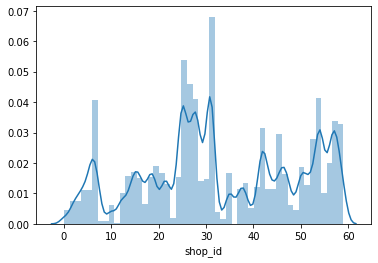

In [ ]:
sns.distplot(x.shop_id)
#shop_id with more sales than others : 

In [ ]:
import plotly.express as px
fig = px.histogram(data,x="shop_id")
fig.show()

In [ ]:
px.histogram(data,x="item_price")
px.histogram(data,x="item_category_id")
px.histogram(data,x="item_cnt_day")
px.histogram(data,x="item_id")

In [ ]:
#now let us apply the model and check 
fts = ['date' , 'date_block_num' , 'shop_id','item_id' , 'item_price' , 'item_cnt_day' , 'item_category_id']
data = data[fts]
data.head(1)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_category_id
0,02.01.2013,0,59,22154,999.0,1.0,37


In [ ]:
# X has shop id and item id but what else !!!
#check for data leakages

In [ ]:
test = test.set_index('ID')#for every shop id and item id we should predict item_cnt_day(target)
test.head(1)

,shop_id,item_id
ID,,
0,5,5037


In [ ]:
sub.head(1)

,ID,item_cnt_month
0,0,0.5


In [ ]:
#so we need to predict monthly expense .......and we have data for daily expense 
# we can group data by block number but we also should preserve the id
data.head(1)

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_category_id
0,02.01.2013,0,59,22154,999.0,1.0,37


In [ ]:
x = data.groupby(data.date_block_num)

#### Todo
### So we need to do feature engineering now 
### We should check if the test data follows some other trends for the two fts as given in test data

### we should check for data leakages if for some shop and some item id if they are asking for the result of item cnt day 


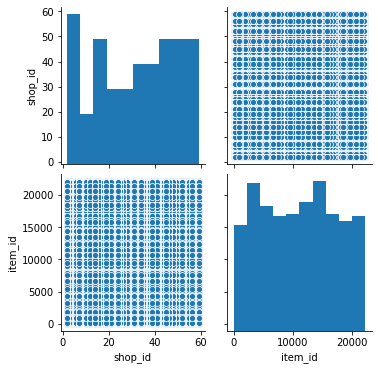

In [ ]:
sns.pairplot(test)

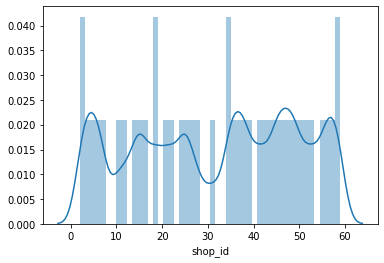

In [ ]:
sns.distplot(test.shop_id)

In [ ]:
test.shop_id.value_counts()
#so every shop is occuring the same number of times 

59    5100
16    5100
28    5100
26    5100
25    5100
24    5100
22    5100
21    5100
19    5100
18    5100
15    5100
58    5100
14    5100
12    5100
10    5100
7     5100
6     5100
5     5100
4     5100
3     5100
31    5100
34    5100
35    5100
36    5100
57    5100
56    5100
55    5100
53    5100
52    5100
50    5100
49    5100
48    5100
47    5100
46    5100
45    5100
44    5100
42    5100
41    5100
39    5100
38    5100
37    5100
2     5100
Name: shop_id, dtype: int64

In [ ]:
data.shop_id.nunique()
data.shop_id.value_counts()

31    235636
25    186104
54    143480
28    142234
57    117428
42    109253
27    105366
6      82663
58     71441
56     69573
46     66321
50     65173
19     63911
15     59511
35     58445
21     58133
7      58076
47     56695
26     53910
18     53227
24     53032
53     52921
16     52734
30     50860
29     49225
38     46013
22     45434
51     44433
52     43502
59     42108
41     41967
37     39638
44     39530
43     39282
4      38242
5      38179
14     36979
45     35891
55     34769
12     34694
2      25991
3      25532
17     22950
48     21612
10     21397
13     17824
49     15849
39     13440
0       9857
32      7947
23      6963
34      5752
1       5678
33      5027
40      4257
9       3751
8       3412
20      1792
11       499
36       306
Name: shop_id, dtype: int64

In [ ]:
test.shape

(214200, 2)

In [ ]:
test.shop_id.nunique()
#so every shop in these 42 shops comes 5100 times in test data  

42

In [ ]:
pd.DataFrame(np.isin(test,data[['shop_id','item_id']]))[1].value_counts()
# if there are
# T-F 15246 entries 
# T-T 198954
#but i want to check as a tuple for a particular shop a aparticualar item should be in the dataset as a tuple

True     198954
False     15246
Name: 1, dtype: int64

In [ ]:
#so we can obs that some new items came into play that were not initially in the sales data but
tot_uniq_items_intersection = np.isin(test.item_id.unique(),data.item_id.unique()).sum()
tot_uniq_items_testset = len(test.item_id.unique())
tot_uniq_items_testset - tot_uniq_items_intersection
#so we can see there are 363 new items that are not in sales train data but we can use the category data from items to make this merge

363

In [ ]:
set([1,2,3]) - set([2,3,4])

{1}

In [ ]:
test = pd.merge(test,items[['item_id','item_category_id']])
test.head()

,shop_id,item_id,item_category_id
0,5,5037,19
1,4,5037,19
2,6,5037,19
3,3,5037,19
4,2,5037,19


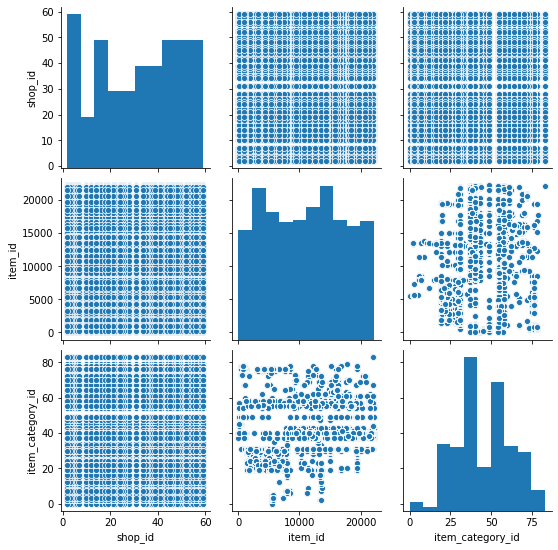

In [ ]:
sns.pairplot(test)

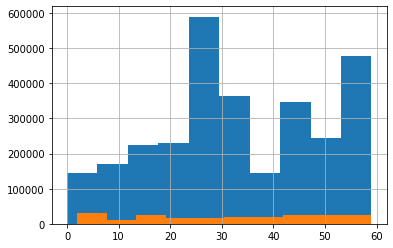

In [ ]:
data.shop_id.hist()
test.shop_id.hist()

In [ ]:
data[(data.item_cnt_day < 0)].item_cnt_day.value_counts()
#these refer to the return of specific items , is there any faulty item whose every copy is returned ????
#we can check that by grouping the item counts means of item ids and finding net item count over a period of time 
#should we remove the entries where one item was bought and then returned later ???

#fact2 -  we can see that some items price increased later on , there can be items whose price may fall also by season (eg clothes)
##fact3 0 how much items are sold every month 

-1.0     7252
-2.0       78
-3.0       14
-5.0        4
-4.0        3
-6.0        2
-9.0        1
-16.0       1
-22.0       1
Name: item_cnt_day, dtype: int64

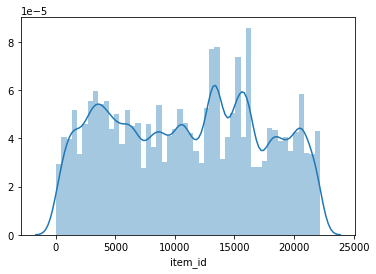

In [ ]:
sns.distplot(test.item_id)

In [ ]:
data.columns
data.dtypes

date                   object
date_block_num          int64
shop_id                 int64
item_id                 int64
item_price            float64
item_cnt_day          float64
item_name              object
item_category_id        int64
shop_name              object
item_category_name     object
dtype: object

### TIME SERIES ANALYSIS


In [ ]:
date = pd.to_datetime(data.date)

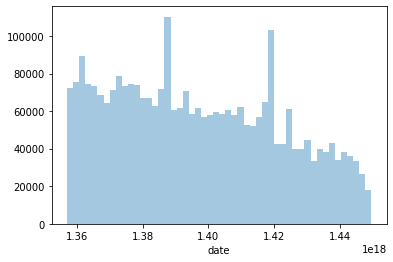

In [ ]:
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
sns.distplot(date,kde=False)

In [ ]:
##check if items are returned back or not 
data.date = pd.to_datetime(data.date)

In [ ]:
data.date = pd.to_datetime(data.date)

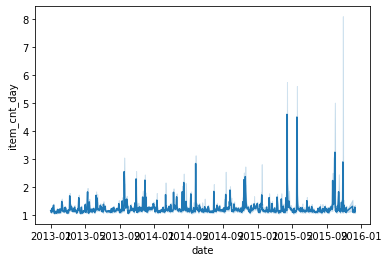

In [ ]:
sns.lineplot(x='date',y='item_cnt_day',data=data)

In [ ]:
sns.lineplot(x='date',y='item_price',data=data)

In [ ]:
sns.pairplot(data)

In [ ]:
sns.lineplot(x='date_block_num' , y='item_price',data=data)

In [ ]:
#sns.lineplot(x='date_block_num' , y='item_cnt_day',data=data)
#hue = 'item_category_id'
#data_copy.drop(['item_name', 'shop_name', 'item_category_name'],axis=1,inplace=True)
data_copy.dtypes

date                datetime64[ns]
date_block_num               int64
shop_id                      int64
item_id                      int64
item_price                 float64
item_cnt_day               float64
item_category_id             int64
dtype: object

##### check if time series is stationary :


In [ ]:
data_copy = data.copy()
import datetime
from statsmodels.tsa.arima_model import ARIMA
data=data.groupby(["date_block_num"])["item_cnt_day"].sum()

In [ ]:
data.head()

,confirmed_date,count
0,2013-01-01,131479.0
1,2013-02-01,128090.0
2,2013-03-01,147142.0
3,2013-04-01,107190.0
4,2013-05-01,106970.0


In [ ]:
data.index=pd.date_range(start = '2013-01-01',end='2015-10-01', freq = 'MS')
data=data.reset_index()
data=data.loc[:,["index","item_cnt_day"]]
data.columns = ['confirmed_date','count']
data.head()

,confirmed_date,count
0,2013-01-01,131479.0
1,2013-02-01,128090.0
2,2013-03-01,147142.0
3,2013-04-01,107190.0
4,2013-05-01,106970.0


In [ ]:
model = ARIMA(data['count'].values, order=(1, 2, 1))
fit_model = model.fit(trend='c', full_output=True, disp=True)
fit_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                             ARIMA Model Results                              
==============================================================================
Dep. Variable:                   D2.y   No. Observations:                   32
Model:                 ARIMA(1, 2, 1)   Log Likelihood                -367.756
Method:                       css-mle   S.D. of innovations          22262.760
Date:                Wed, 03 Jun 2020   AIC                            743.512
Time:                        13:22:58   BIC                            749.375
Sample:                             2   HQIC                           745.456
                                                                              
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const        -73.2828    329.027     -0.223      0.825    -718.165     571.599
ar.L1.D2.y    -0.2607      0.168     -1.552      0.131      -0.590       0.068
ma.L1.D2.y    -1.0000      0.084    -11.969      0.000      -1.164      -0.836
                                    Roots                                    
=============================================================================
                  Real          Imaginary           Modulus         Frequency
-----------------------------------------------------------------------------
AR.1           -3.8366           +0.0000j            3.8366            0.5000
MA.1            1.0000           +0.0000j            1.0000            0.0000
-----------------------------------------------------------------------------
"""

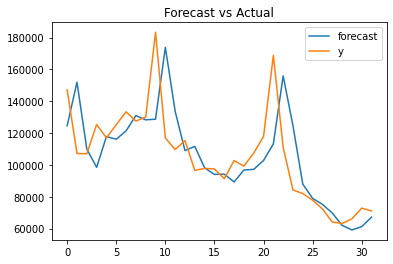

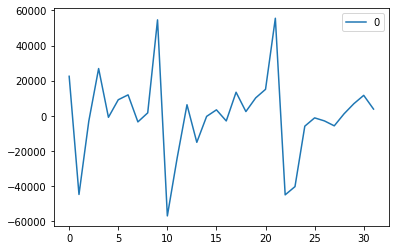

In [ ]:
fit_model.plot_predict()
plt.title('Forecast vs Actual')
pd.DataFrame(fit_model.resid).plot()
forcast = fit_model.forecast(steps=6)
pred_y = forcast[0].tolist()
pred = pd.DataFrame(pred_y)

In [ ]:
pd.Series(pred_y).to_csv('arima.csv')

In [ ]:
data.head()
data_copy.head()

,date,date_block_num,shop_id,item_id,item_price,item_cnt_day,item_category_id
0,2013-02-01,0,59,22154,999.0,1.0,37
1,2013-04-26,3,59,944,150.0,1.0,37
2,2013-06-26,5,59,944,199.5,1.0,37
3,2013-07-20,6,59,944,199.5,1.0,37
4,2013-09-14,8,59,944,299.0,2.0,37


In [ ]:
from statsmodels.tsa.stattools import adfuller 
rollmean = data.rolling(window=1)
"""

def test_stationarity(timeseries):
        #Determing rolling statistics
    rolmean = pd.rolling_mean(timeseries, window=24) # 24 hours on each day
    rolstd = pd.rolling_std(timeseries, window=24)
        #Plot rolling statistics:
    orig = plt.plot(timeseries, color='blue',label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label = 'Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
        #Perform Dickey-Fuller test:
    print ('Results of Dickey-Fuller Test:')
    dftest = adfuller(timeseries, autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])

    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
    print(dfoutput)
"""

"\n\ndef test_stationarity(timeseries):\n        #Determing rolling statistics\n    rolmean = pd.rolling_mean(timeseries, window=24) # 24 hours on each day\n    rolstd = pd.rolling_std(timeseries, window=24)\n        #Plot rolling statistics:\n    orig = plt.plot(timeseries, color='blue',label='Original')\n    mean = plt.plot(rolmean, color='red', label='Rolling Mean')\n    std = plt.plot(rolstd, color='black', label = 'Rolling Std')\n    plt.legend(loc='best')\n    plt.title('Rolling Mean & Standard Deviation')\n    plt.show(block=False)\n        #Perform Dickey-Fuller test:\n    print ('Results of Dickey-Fuller Test:')\n    dftest = adfuller(timeseries, autolag='AIC')\n    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])\n\n    for key,value in dftest[4].items():\n        dfoutput['Critical Value (%s)'%key] = value\n    print (dfoutput)\n"

NotImplementedError: ignored

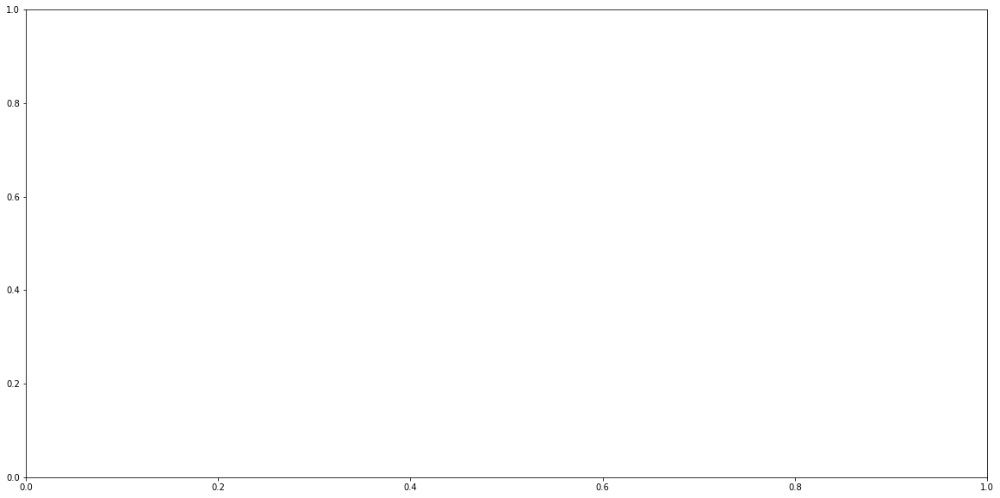

In [ ]:
plt.plot(rollmean)